In [1]:
def is_notebook() -> bool:
    try:
        shell = get_ipython().__class__.__name__
        if shell == "ZMQInteractiveShell":
            return True  # Jupyter notebook or qtconsole
        elif shell == "TerminalInteractiveShell":
            return False  # Terminal running IPython
        else:
            return False  # Other type (?)
    except NameError:
        return False  # Probably standard Python interpreter

# Imports

In [2]:
import math
import os
import pickle
import random
import shutil
import sys
import time
from collections import defaultdict
from dataclasses import dataclass
from datetime import datetime
from enum import Enum, auto
from functools import partial
from typing import Any, Dict, List, Optional

import h5py
import numpy as np
import plotly.graph_objects as go
import torch
import torch.nn as nn
from hydra import compose, initialize
from hydra.core.config_store import ConfigStore
from hydra.utils import instantiate
from localscope import localscope
from omegaconf import MISSING, OmegaConf
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
from sklearn.utils.class_weight import compute_class_weight
from torch.utils.data import DataLoader, Dataset, Subset, random_split
from torchinfo import summary
from torchviz import make_dot
from wandb.util import generate_id

import wandb

In [3]:
if is_notebook():
    from tqdm.notebook import tqdm as std_tqdm
else:
    from tqdm import tqdm as std_tqdm

tqdm = partial(std_tqdm, dynamic_ncols=True)

# Setup Config for Static Type-Checking

In [4]:
OmegaConf.register_new_resolver("eval", eval, replace=True)
OmegaConf.register_new_resolver(
    "datetime_str", lambda: datetime.now().strftime("%Y-%m-%d_%H-%M-%S"), replace=True
)

In [5]:
@dataclass
class WandbConfig:
    entity: str = MISSING
    project: str = MISSING
    name: str = MISSING
    group: str = MISSING
    job_type: str = MISSING


@dataclass
class DataConfig:
    frac_val: float = MISSING
    frac_test: float = MISSING
    frac_train: float = MISSING

    input_dataset_path: str = MISSING
    batch_size: int = MISSING
    dataloader_num_workers: int = MISSING
    dataloader_pin_memory: bool = MISSING


@dataclass
class TrainingConfig:
    grad_clip_val: float = MISSING
    lr: float = MISSING
    n_epochs: int = MISSING
    log_grad_freq: int = MISSING
    log_grad_on_epoch_0: bool = MISSING
    val_freq: int = MISSING
    val_on_epoch_0: bool = MISSING
    save_checkpoint_freq: int = MISSING
    save_checkpoint_on_epoch_0: bool = MISSING
    confusion_matrix_freq: int = MISSING
    save_confusion_matrix_on_epoch_0: bool = MISSING


class ConvOutputTo1D(Enum):
    FLATTEN = auto()  # (N, C, H, W) -> (N, C*H*W)
    AVG_POOL_SPATIAL = auto()  # (N, C, H, W) -> (N, C, 1, 1) -> (N, C)
    AVG_POOL_CHANNEL = auto()  # (N, C, H, W) -> (N, 1, H, W) -> (N, H*W)
    MAX_POOL_SPATIAL = auto()  # (N, C, H, W) -> (N, C, 1, 1) -> (N, C)
    MAX_POOL_CHANNEL = auto()  # (N, C, H, W) -> (N, 1, H, W) -> (N, H*W)


class PoolType(Enum):
    MAX = auto()
    AVG = auto()


@dataclass
class NeuralNetworkConfig:
    conv_channels: List[int] = MISSING
    pool_type: PoolType = MISSING
    dropout_prob: float = MISSING
    conv_output_to_1d: ConvOutputTo1D = MISSING
    mlp_hidden_layers: List[int] = MISSING


@dataclass
class CheckpointWorkspaceConfig:
    root_dir: str = MISSING
    leaf_dir: str = MISSING
    force_no_resume: bool = MISSING


@dataclass
class Config:
    data: DataConfig = MISSING
    wandb: WandbConfig = MISSING
    training: TrainingConfig = MISSING
    neural_network: NeuralNetworkConfig = MISSING
    checkpoint_workspace: CheckpointWorkspaceConfig = MISSING
    random_seed: int = MISSING
    visualize_data: bool = MISSING

In [6]:
config_store = ConfigStore.instance()
config_store.store(name="config", node=Config)

# Load Config

In [7]:
if is_notebook():
    arguments = [
        "data.input_dataset_path=nerf_acronym_grasp_success_dataset_3_categories.h5",  # TODO REMOVE
        "wandb.name=large-model_normalize_3-categories",
    ]
else:
    arguments = sys.argv[1:]
    print(f"arguments = {arguments}")

In [8]:
from hydra.errors import ConfigCompositionException
from omegaconf.errors import ValidationError

try:
    with initialize(version_base="1.1", config_path="Train_NeRF_Grasp_Metric_cfg"):
        raw_cfg = compose(config_name="config", overrides=arguments)

    # Runtime type-checking
    cfg: Config = instantiate(raw_cfg)
except ConfigCompositionException as e:
    print(f"ConfigCompositionException: {e}")
    print()
    print(f"e.__cause__ = {e.__cause__}")
    exit()

/juno/u/tylerlum/miniconda3/envs/nerf_grasping_env/lib/python3.8/site-packages/IPython/core/async_helpers.py:129: UserWarning: 
'config' is validated against ConfigStore schema with the same name.
This behavior is deprecated in Hydra 1.1 and will be removed in Hydra 1.2.
See https://hydra.cc/docs/1.2/upgrades/1.0_to_1.1/automatic_schema_matching for migration instructions.
  coro.send(None)


In [9]:
print(f"Config:\n{OmegaConf.to_yaml(cfg)}")

Config:
data:
  frac_val: 0.25
  frac_test: 0.15
  frac_train: 0.6
  input_dataset_path: nerf_acronym_grasp_success_dataset_3_categories.h5
  batch_size: 128
  dataloader_num_workers: 8
  dataloader_pin_memory: false
wandb:
  entity: tylerlum
  project: NeRF_Grasp_Metric_V1
  name: large-model_normalize_3-categories
  group: ''
  job_type: ''
training:
  grad_clip_val: 1.0
  lr: 0.001
  n_epochs: 20
  log_grad_freq: 5
  log_grad_on_epoch_0: true
  val_freq: 5
  val_on_epoch_0: true
  save_checkpoint_freq: 5
  save_checkpoint_on_epoch_0: true
  confusion_matrix_freq: 5
  save_confusion_matrix_on_epoch_0: true
neural_network:
  conv_channels:
  - 32
  - 64
  - 128
  - 256
  pool_type: MAX
  dropout_prob: 0.0
  conv_output_to_1d: AVG_POOL_SPATIAL
  mlp_hidden_layers:
  - 256
  - 256
  - 256
checkpoint_workspace:
  root_dir: Train_NeRF_Grasp_Metric_workspaces
  leaf_dir: large-model_normalize_3-categories
  force_no_resume: true
random_seed: 42
visualize_data: true



# Set Random Seed

In [10]:
@localscope.mfc
def set_seed(seed):
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    torch.set_num_threads(1)  # TODO: Is this slowing things down?

    # torch.backends.cudnn.deterministic = True
    # torch.backends.cudnn.benchmark = False
    os.environ["PYTHONHASHSEED"] = str(seed)
    print(f"Set random seed to {seed}")


set_seed(cfg.random_seed)

Set random seed to 42


# Setup Checkpoint Workspace and Maybe Resume Previous Run

In [11]:
@localscope.mfc
def load_checkpoint(checkpoint_workspace_dir_path: str) -> Optional[Dict[str, Any]]:
    checkpoint_filepaths = sorted(
        [
            os.path.join(checkpoint_workspace_dir_path, filename)
            for filename in os.listdir(checkpoint_workspace_dir_path)
            if filename.endswith(".pt")
        ]
    )
    if len(checkpoint_filepaths) == 0:
        print("No checkpoint found")
        return None
    return torch.load(checkpoint_filepaths[-1])

In [12]:
# Set up checkpoint_workspace
if not os.path.exists(cfg.checkpoint_workspace.root_dir):
    os.makedirs(cfg.checkpoint_workspace.root_dir)

checkpoint_workspace_dir_path = os.path.join(
    cfg.checkpoint_workspace.root_dir, cfg.checkpoint_workspace.leaf_dir
)

# Remove checkpoint_workspace directory if force_no_resume is set
if (
    os.path.exists(checkpoint_workspace_dir_path)
    and cfg.checkpoint_workspace.force_no_resume
):
    print(f"force_no_resume = {cfg.checkpoint_workspace.force_no_resume}")
    print(f"Removing checkpoint_workspace directory at {checkpoint_workspace_dir_path}")
    shutil.rmtree(checkpoint_workspace_dir_path)
    print("Done removing checkpoint_workspace directory")

# Read wandb_run_id from checkpoint_workspace if it exists
wandb_run_id_filepath = os.path.join(checkpoint_workspace_dir_path, "wandb_run_id.txt")
if os.path.exists(checkpoint_workspace_dir_path):
    print(
        f"checkpoint_workspace directory already exists at {checkpoint_workspace_dir_path}"
    )

    print(f"Loading wandb_run_id from {wandb_run_id_filepath}")
    with open(wandb_run_id_filepath, "r") as f:
        wandb_run_id = f.read()
    print(f"Done loading wandb_run_id = {wandb_run_id}")

else:
    print(f"Creating checkpoint_workspace directory at {checkpoint_workspace_dir_path}")
    os.makedirs(checkpoint_workspace_dir_path)
    print("Done creating checkpoint_workspace directory")

    wandb_run_id = generate_id()
    print(f"Saving wandb_run_id = {wandb_run_id} to {wandb_run_id_filepath}")
    with open(wandb_run_id_filepath, "w") as f:
        f.write(wandb_run_id)
    print("Done saving wandb_run_id")

force_no_resume = True
Removing checkpoint_workspace directory at Train_NeRF_Grasp_Metric_workspaces/large-model_normalize_3-categories
Done removing checkpoint_workspace directory
Creating checkpoint_workspace directory at Train_NeRF_Grasp_Metric_workspaces/large-model_normalize_3-categories
Done creating checkpoint_workspace directory
Saving wandb_run_id = 3sk0g3zl to Train_NeRF_Grasp_Metric_workspaces/large-model_normalize_3-categories/wandb_run_id.txt
Done saving wandb_run_id


# Setup Wandb Logging

In [13]:
# Add to config
wandb.init(
    entity=cfg.wandb.entity,
    project=cfg.wandb.project,
    name=cfg.wandb.name,
    group=cfg.wandb.group if len(cfg.wandb.group) > 0 else None,
    job_type=cfg.wandb.job_type if len(cfg.wandb.job_type) > 0 else None,
    config=OmegaConf.to_container(cfg, throw_on_missing=True),
    id=wandb_run_id,
    resume="never" if cfg.checkpoint_workspace.force_no_resume else "allow",
    reinit=True,
    # settings=wandb.Settings(start_method="fork"),  # Fix for wandb init error, but stops wandb from logging
)

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin


# Dataset and Dataloader

In [14]:
# CONSTANTS AND PARAMS
ROOT_DIR = "../../"
NUM_PTS_X, NUM_PTS_Y, NUM_PTS_Z = 83, 21, 37
NUM_XYZ = 3
NUM_DENSITY = 1
NUM_CHANNELS = NUM_XYZ + NUM_DENSITY
INPUT_EXAMPLE_SHAPE = (NUM_CHANNELS, NUM_PTS_X, NUM_PTS_Y, NUM_PTS_Z)
NERF_COORDINATE_START_IDX, NERF_COORDINATE_END_IDX = 0, 3
NERF_DENSITY_START_IDX, NERF_DENSITY_END_IDX = 3, 4

assert NERF_COORDINATE_END_IDX == NERF_COORDINATE_START_IDX + NUM_XYZ
assert NERF_DENSITY_END_IDX == NERF_DENSITY_START_IDX + NUM_DENSITY

In [15]:
class NeRFGrid_To_GraspSuccess_Dataset(Dataset):
    # @localscope.mfc  # ValueError: Cell is empty
    def __init__(self, input_dataset_path):
        super().__init__()
        self.input_dataset_path = input_dataset_path
        self.filepaths = self._get_filepaths(input_dataset_path)

    @localscope.mfc
    def _get_filepaths(self, input_dataset_path):
        return [
            os.path.join(input_dataset_path, object_dir, filepath)
            for object_dir in os.listdir(input_dataset_path)
            for filepath in os.listdir(os.path.join(input_dataset_path, object_dir))
            if filepath.endswith(".pkl")
        ]

    @localscope.mfc
    def __len__(self):
        return len(self.filepaths)

    @localscope.mfc(allowed=["INPUT_EXAMPLE_SHAPE"])
    def __getitem__(self, idx):
        # Read pickle ifle
        with open(self.filepaths[idx], "rb") as f:
            data_dict = pickle.load(f)

        nerf_grid_input = torch.from_numpy(data_dict["nerf_grid_input"]).float()
        grasp_success = torch.from_numpy(np.array(data_dict["grasp_success"])).long()
        assert nerf_grid_input.shape == INPUT_EXAMPLE_SHAPE
        assert grasp_success.shape == ()

        return nerf_grid_input, grasp_success

In [16]:
class NeRFGrid_To_GraspSuccess_ALL_Dataset(Dataset):
    # @localscope.mfc  # ValueError: Cell is empty
    def __init__(self, input_dataset_path):
        super().__init__()
        self.input_dataset_path = input_dataset_path
        self.filepaths = self._get_filepaths(input_dataset_path)

        # Read all pickle files
        self.nerf_grid_inputs = []
        self.grasp_successes = []
        for filepath in tqdm(self.filepaths):
            with open(filepath, "rb") as f:
                data_dict = pickle.load(f)

            nerf_grid_input = torch.from_numpy(data_dict["nerf_grid_input"]).float()
            grasp_success = torch.from_numpy(
                np.array(data_dict["grasp_success"])
            ).long()
            self.nerf_grid_inputs.append(nerf_grid_input)
            self.grasp_successes.append(grasp_success)

    @localscope.mfc
    def _get_filepaths(self, input_dataset_path):
        return [
            os.path.join(input_dataset_path, object_dir, filepath)
            for object_dir in os.listdir(input_dataset_path)
            for filepath in os.listdir(os.path.join(input_dataset_path, object_dir))
            if filepath.endswith(".pkl")
        ]

    @localscope.mfc
    def __len__(self):
        return len(self.filepaths)

    @localscope.mfc
    def __getitem__(self, idx):
        return self.nerf_grid_inputs[idx], self.grasp_successes[idx]

In [17]:
class NeRFGrid_To_GraspSuccess_HDF5_Dataset(Dataset):
    # @localscope.mfc  # ValueError: Cell is empty
    def __init__(self, input_hdf5_filepath):
        super().__init__()
        self.input_hdf5_filepath = input_hdf5_filepath
        self.hdf5_file = None

        # This is small enough to fit in RAM
        with h5py.File(self.input_hdf5_filepath, "r") as hdf5_file:
            self.grasp_successes = torch.from_numpy(
                np.array(hdf5_file["/grasp_success"][()])
            ).long()
        self.len = self.grasp_successes.shape[0]
        assert self.grasp_successes.shape == (self.len,)

    @localscope.mfc
    def __len__(self):
        return self.len

    @localscope.mfc(allowed=["INPUT_EXAMPLE_SHAPE"])
    def __getitem__(self, idx):
        if self.hdf5_file is None:
            self.hdf5_file = h5py.File(self.input_hdf5_filepath, "r")

        nerf_grid_input = torch.from_numpy(
            self.hdf5_file["/nerf_grid_input"][idx]
        ).float()
        grasp_success = self.grasp_successes[idx]
        assert nerf_grid_input.shape == INPUT_EXAMPLE_SHAPE
        assert grasp_success.shape == ()

        return nerf_grid_input, grasp_success

In [18]:
class NeRFGrid_To_GraspSuccess_HDF5_ALL_Dataset(Dataset):
    # @localscope.mfc  # ValueError: Cell is empty
    def __init__(self, input_hdf5_filepath):
        super().__init__()
        self.input_hdf5_filepath = input_hdf5_filepath
        self.hdf5_file = h5py.File(input_hdf5_filepath, "r")
        self.len = self.hdf5_file["/grasp_success"].shape[0]

        # Read all elements of the dataset
        self.nerf_grid_inputs = torch.from_numpy(
            self.hdf5_file["/nerf_grid_input"][()]
        ).float()
        self.grasp_successes = torch.from_numpy(
            np.array(self.hdf5_file["/grasp_success"][()])
        ).long()

    @localscope.mfc
    def __len__(self):
        return self.len

    @localscope.mfc
    def __getitem__(self, idx):
        return self.nerf_grid_inputs[idx], self.grasp_successes[idx]

In [19]:
class DatasetType(Enum):
    PKL_FILES = auto()
    HDF5_FILE = auto()
    PKL_FILES_ALL = auto()
    HDF5_FILE_ALL = auto()  # Won't fit in memory


dataset_type = (
    DatasetType.HDF5_FILE
    if cfg.data.input_dataset_path.endswith(".h5")
    else DatasetType.PKL_FILES
)

if dataset_type == DatasetType.PKL_FILES_ALL:
    full_dataset = NeRFGrid_To_GraspSuccess_ALL_Dataset(
        os.path.join(ROOT_DIR, cfg.data.input_dataset_path)
    )
elif dataset_type == DatasetType.HDF5_FILE_ALL:
    full_dataset = NeRFGrid_To_GraspSuccess_HDF5_ALL_Dataset(
        os.path.join(ROOT_DIR, cfg.data.input_dataset_path)
    )
elif dataset_type == DatasetType.PKL_FILES:
    full_dataset = NeRFGrid_To_GraspSuccess_Dataset(
        os.path.join(ROOT_DIR, cfg.data.input_dataset_path)
    )
elif dataset_type == DatasetType.HDF5_FILE:
    full_dataset = NeRFGrid_To_GraspSuccess_HDF5_Dataset(
        os.path.join(ROOT_DIR, cfg.data.input_dataset_path)
    )
else:
    raise ValueError(f"Unknown dataset type: {dataset_type}")

train_dataset, val_dataset, test_dataset = random_split(
    full_dataset,
    [cfg.data.frac_train, cfg.data.frac_val, cfg.data.frac_test],
    generator=torch.Generator().manual_seed(cfg.random_seed),
)

In [20]:
print(f"Train dataset size: {len(train_dataset)}")
print(f"Val dataset size: {len(val_dataset)}")
print(f"Test dataset size: {len(test_dataset)}")

Train dataset size: 3600
Val dataset size: 1500
Test dataset size: 900


In [21]:
assert len(set.intersection(set(train_dataset.indices), set(val_dataset.indices))) == 0
assert len(set.intersection(set(train_dataset.indices), set(test_dataset.indices))) == 0
assert len(set.intersection(set(val_dataset.indices), set(test_dataset.indices))) == 0

In [22]:
train_loader = DataLoader(
    train_dataset,
    batch_size=cfg.data.batch_size,
    shuffle=True,
    pin_memory=cfg.data.dataloader_pin_memory,
    num_workers=cfg.data.dataloader_num_workers,
)
val_loader = DataLoader(
    val_dataset,
    batch_size=cfg.data.batch_size,
    shuffle=False,
    pin_memory=cfg.data.dataloader_pin_memory,
    num_workers=cfg.data.dataloader_num_workers,
)
test_loader = DataLoader(
    test_dataset,
    batch_size=cfg.data.batch_size,
    shuffle=False,
    pin_memory=cfg.data.dataloader_pin_memory,
    num_workers=cfg.data.dataloader_num_workers,
)

In [23]:
print(f"Train loader size: {len(train_loader)}")
print(f"Val loader size: {len(val_loader)}")
print(f"Test loader size: {len(test_loader)}")

Train loader size: 29
Val loader size: 12
Test loader size: 8


In [24]:
assert math.ceil(len(train_dataset) / cfg.data.batch_size) == len(train_loader)
assert math.ceil(len(val_dataset) / cfg.data.batch_size) == len(val_loader)
assert math.ceil(len(test_dataset) / cfg.data.batch_size) == len(test_loader)

# Visualize Datapoint

In [25]:
@localscope.mfc
def get_isaac_origin_lines():
    x_line_np = np.array([[0.0, 0.0, 0.0], [0.1, 0.0, 0.0]])
    y_line_np = np.array([[0.0, 0.0, 0.0], [0.0, 0.1, 0.0]])
    z_line_np = np.array([[0.0, 0.0, 0.0], [0.0, 0.0, 0.1]])

    lines = []
    for line_np, name, color in [
        (x_line_np, "X", "red"),
        (y_line_np, "Y", "green"),
        (z_line_np, "Z", "blue"),
    ]:
        lines.append(
            go.Scatter3d(
                x=line_np[:, 0],
                y=line_np[:, 1],
                z=line_np[:, 2],
                mode="lines",
                line=dict(width=2, color=color),
                name=f"Isaac Origin {name} Axis",
            )
        )
    return lines


@localscope.mfc(allowed=["NUM_XYZ"])
def get_colored_points_scatter(points, colors):
    assert len(points.shape) == 2 and points.shape[1] == NUM_XYZ
    assert len(colors.shape) == 1

    # Use plotly to make scatter3d plot
    scatter = go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode="markers",
        marker=dict(
            size=5,
            color=colors,
            colorscale="viridis",
            colorbar=dict(title="Density Scale"),
        ),
        name="Query Point Densities",
    )

    return scatter

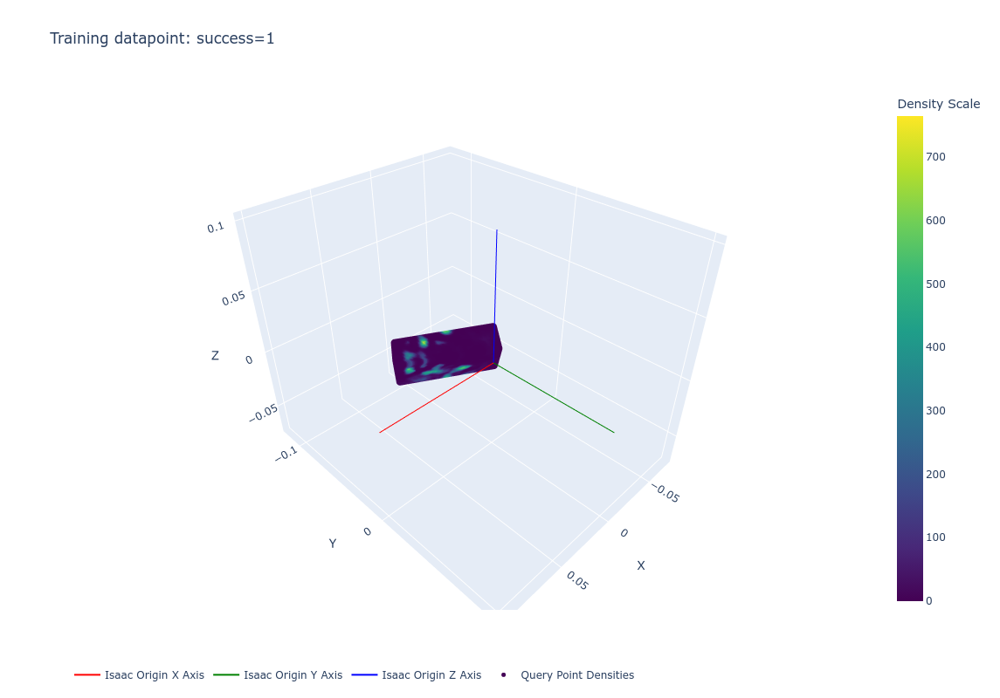

In [26]:
if cfg.visualize_data:
    idx_to_visualize = 0
    for nerf_grid_inputs, grasp_successes in train_loader:
        assert nerf_grid_inputs.shape == (
            cfg.data.batch_size,
            *INPUT_EXAMPLE_SHAPE,
        )
        assert grasp_successes.shape == (cfg.data.batch_size,)

        nerf_grid_input = nerf_grid_inputs[idx_to_visualize]
        assert nerf_grid_input.shape == INPUT_EXAMPLE_SHAPE

        nerf_densities = nerf_grid_input[NERF_DENSITY_START_IDX:NERF_DENSITY_END_IDX, :, :, :]
        assert nerf_densities.shape == (NUM_DENSITY, NUM_PTS_X, NUM_PTS_Y, NUM_PTS_Z)

        nerf_points = nerf_grid_input[NERF_COORDINATE_START_IDX:NERF_COORDINATE_END_IDX].permute(1, 2, 3, 0)
        assert nerf_points.shape == (NUM_PTS_X, NUM_PTS_Y, NUM_PTS_Z, NUM_XYZ)

        isaac_origin_lines = get_isaac_origin_lines()
        colored_points_scatter = get_colored_points_scatter(
            nerf_points.reshape(-1, NUM_XYZ), nerf_densities.reshape(-1)
        )

        layout = go.Layout(
            scene=dict(xaxis=dict(title="X"), yaxis=dict(title="Y"), zaxis=dict(title="Z")),
            showlegend=True,
            title=f"Training datapoint: success={grasp_successes[idx_to_visualize].item()}",
            width=800,
            height=800,
        )

        # Create the figure
        fig = go.Figure(layout=layout)
        for line in isaac_origin_lines:
            fig.add_trace(line)
        fig.add_trace(colored_points_scatter)
        fig.update_layout(legend_orientation="h")
        fig.show()
        break

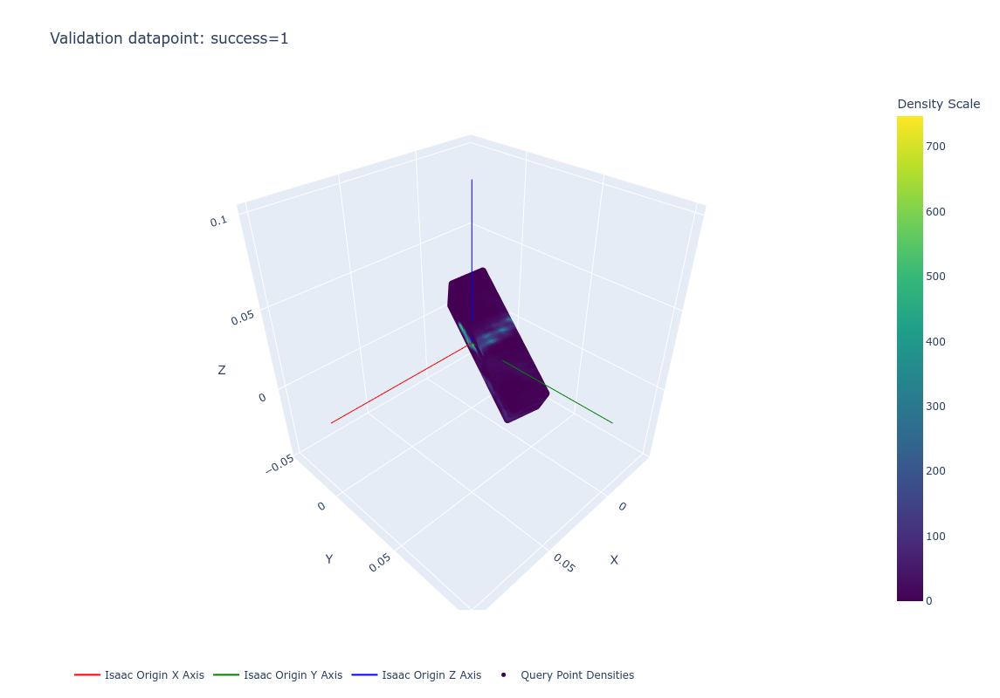

In [27]:
if cfg.visualize_data:
    idx_to_visualize = 0
    for nerf_grid_inputs, grasp_successes in val_loader:
        assert nerf_grid_inputs.shape == (
            cfg.data.batch_size,
            *INPUT_EXAMPLE_SHAPE,
        )
        assert grasp_successes.shape == (cfg.data.batch_size,)

        nerf_grid_input = nerf_grid_inputs[idx_to_visualize]
        assert nerf_grid_input.shape == INPUT_EXAMPLE_SHAPE

        nerf_densities = nerf_grid_input[NERF_DENSITY_START_IDX:NERF_DENSITY_END_IDX, :, :, :]
        assert nerf_densities.shape == (NUM_DENSITY, NUM_PTS_X, NUM_PTS_Y, NUM_PTS_Z)

        nerf_points = nerf_grid_input[NERF_COORDINATE_START_IDX:NERF_COORDINATE_END_IDX].permute(1, 2, 3, 0)
        assert nerf_points.shape == (NUM_PTS_X, NUM_PTS_Y, NUM_PTS_Z, NUM_XYZ)

        isaac_origin_lines = get_isaac_origin_lines()
        colored_points_scatter = get_colored_points_scatter(
            nerf_points.reshape(-1, NUM_XYZ), nerf_densities.reshape(-1)
        )

        layout = go.Layout(
            scene=dict(xaxis=dict(title="X"), yaxis=dict(title="Y"), zaxis=dict(title="Z")),
            showlegend=True,
            title=f"Validation datapoint: success={grasp_successes[idx_to_visualize].item()}",
            width=800,
            height=800,
        )

        # Create the figure
        fig = go.Figure(layout=layout)
        for line in isaac_origin_lines:
            fig.add_trace(line)
        fig.add_trace(colored_points_scatter)
        fig.update_layout(legend_orientation="h")
        fig.show()
        break

# Visualize Dataset Distribution

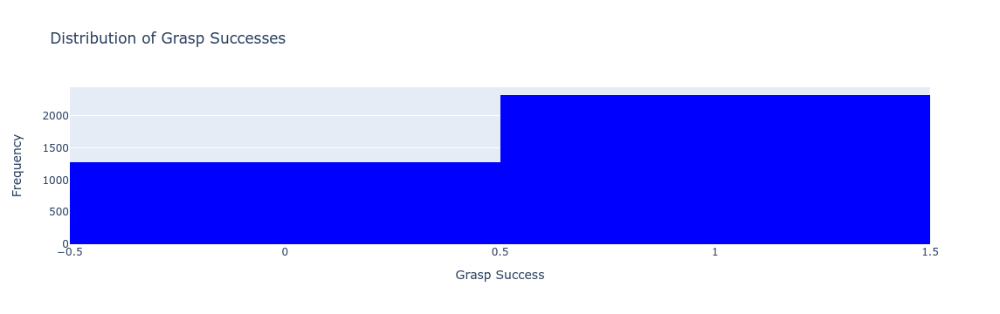

In [28]:
try:
    if cfg.visualize_data:
        grasp_successes_np = train_dataset.dataset.grasp_successes[
            train_dataset.indices
        ].numpy()

        # Plot histogram in plotly
        fig = go.Figure(
            data=[
                go.Histogram(
                    x=grasp_successes_np,
                    name="Train",
                    marker_color="blue",
                ),
            ],
            layout=go.Layout(
                title="Distribution of Grasp Successes",
                xaxis=dict(title="Grasp Success"),
                yaxis=dict(title="Frequency"),
            ),
        )
        fig.show()
except Exception as e:
    print(f"Error: {e}")
    print("Skipping visualization of grasp success distribution")

In [29]:
nerf_coordinate_mins, nerf_coordinate_means, nerf_coordinate_maxs = [], [], []
nerf_density_mins, nerf_density_means, nerf_density_maxs = [], [], []
for nerf_grid_inputs, _ in tqdm(
    train_loader, desc="Calculating nerf_grid_inputs dataset statistics"
):
    assert nerf_grid_inputs.shape[1:] == INPUT_EXAMPLE_SHAPE
    nerf_coordinates = nerf_grid_inputs[:, NERF_COORDINATE_START_IDX:NERF_COORDINATE_END_IDX]
    nerf_densities = nerf_grid_inputs[:, NERF_DENSITY_START_IDX:NERF_DENSITY_END_IDX]

    nerf_coordinate_mins.append(nerf_coordinates.min().item())
    nerf_coordinate_means.append(nerf_coordinates.mean().item())
    nerf_coordinate_maxs.append(nerf_coordinates.max().item())

    nerf_density_mins.append(nerf_densities.min().item())
    nerf_density_means.append(nerf_densities.mean().item())
    nerf_density_maxs.append(nerf_densities.max().item())

nerf_coordinate_mins, nerf_coordinate_means, nerf_coordinate_maxs = (
    np.array(nerf_coordinate_mins),
    np.array(nerf_coordinate_means),
    np.array(nerf_coordinate_maxs),
)
nerf_coordinate_min = nerf_coordinate_mins.min()
nerf_coordinate_mean = nerf_coordinate_means.mean()
nerf_coordinate_max = nerf_coordinate_maxs.max()
print(f"nerf_coordinate_min: {nerf_coordinate_min}")
print(f"nerf_coordinate_mean: {nerf_coordinate_mean}")
print(f"nerf_coordinate_max: {nerf_coordinate_max}")

nerf_density_mins, nerf_density_means, nerf_density_maxs = (
    np.array(nerf_density_mins),
    np.array(nerf_density_means),
    np.array(nerf_density_maxs),
)
nerf_density_min = nerf_density_mins.min()
nerf_density_mean = nerf_density_means.mean()
nerf_density_max = nerf_density_maxs.max()
print(f"nerf_density_min: {nerf_density_min}")
print(f"nerf_density_mean: {nerf_density_mean}")
print(f"nerf_density_max: {nerf_density_max}")

Calculating nerf_grid_inputs dataset statistics:   0%|                                                       |…

nerf_coordinate_min: -0.1478663980960846
nerf_coordinate_mean: -0.0008155077620327136
nerf_coordinate_max: 0.1404326856136322
nerf_density_min: 0.0
nerf_density_mean: 48.171002092032595
nerf_density_max: 5913.31396484375


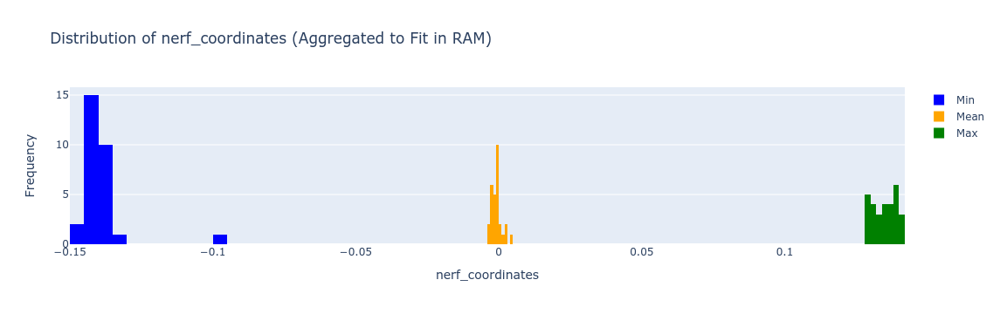

In [30]:
# Plot histogram of min, mean, and max values of nerf_coordinates
fig = go.Figure(
    data=[
        go.Histogram(
            x=nerf_coordinate_mins,
            name="Min",
            marker_color="blue",
        ),
        go.Histogram(
            x=nerf_coordinate_means,
            name="Mean",
            marker_color="orange",
        ),
        go.Histogram(
            x=nerf_coordinate_maxs,
            name="Max",
            marker_color="green",
        ),
    ],
    layout=go.Layout(
        title="Distribution of nerf_coordinates (Aggregated to Fit in RAM)",
        xaxis=dict(title="nerf_coordinates"),
        yaxis=dict(title="Frequency"),
        barmode="overlay",
    ),
)
fig.show()

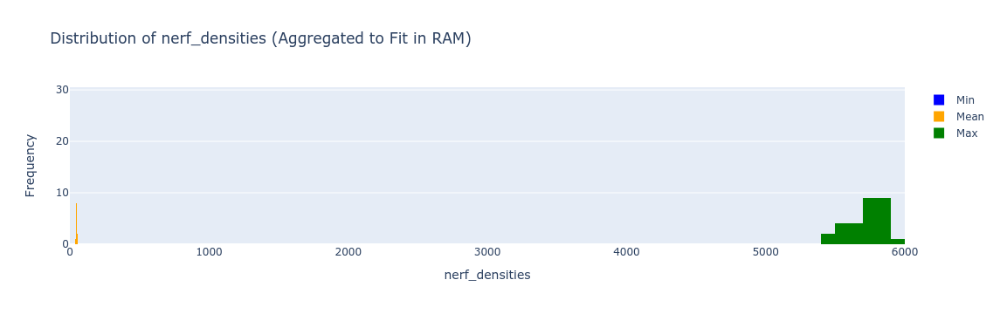

In [31]:
# Plot histogram of min, mean, and max values of nerf_densities
fig = go.Figure(
    data=[
        go.Histogram(
            x=nerf_density_mins,
            name="Min",
            marker_color="blue",
        ),
        go.Histogram(
            x=nerf_density_means,
            name="Mean",
            marker_color="orange",
        ),
        go.Histogram(
            x=nerf_density_maxs,
            name="Max",
            marker_color="green",
        ),
    ],
    layout=go.Layout(
        title="Distribution of nerf_densities (Aggregated to Fit in RAM)",
        xaxis=dict(title="nerf_densities"),
        yaxis=dict(title="Frequency"),
        barmode="overlay",
    ),
)
fig.show()

# Create Neural Network Model

In [32]:
@localscope.mfc
def mlp(
    num_inputs,
    num_outputs,
    hidden_layers,
    activation=nn.ReLU,
    output_activation=nn.Identity,
):
    layers = []
    layer_sizes = [num_inputs] + hidden_layers + [num_outputs]
    for i in range(len(layer_sizes) - 1):
        act = activation if i < len(layer_sizes) - 2 else output_activation
        layers += [nn.Linear(layer_sizes[i], layer_sizes[i + 1]), act()]
    return nn.Sequential(*layers)


class Mean(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, x):
        return torch.mean(x, dim=self.dim)


class Max(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, x):
        return torch.max(x, dim=self.dim)


@localscope.mfc
def conv_encoder(
    input_shape,
    conv_channels,
    pool_type=PoolType.MAX,
    dropout_prob=0.0,
    conv_output_to_1d=ConvOutputTo1D.FLATTEN,
    activation=nn.ReLU,
):
    # Input: Either (n_channels, n_dims) or (n_channels, height, width) or (n_channels, depth, height, width)

    # Validate input
    assert 2 <= len(input_shape) <= 4
    n_input_channels = input_shape[0]
    n_spatial_dims = len(input_shape[1:])

    # Layers for different input sizes
    n_spatial_dims_to_conv_layer_map = {1: nn.Conv1d, 2: nn.Conv2d, 3: nn.Conv3d}
    n_spatial_dims_to_maxpool_layer_map = {
        1: nn.MaxPool1d,
        2: nn.MaxPool2d,
        3: nn.MaxPool3d,
    }
    n_spatial_dims_to_avgpool_layer_map = {
        1: nn.AvgPool1d,
        2: nn.AvgPool2d,
        3: nn.AvgPool3d,
    }
    n_spatial_dims_to_dropout_layer_map = {
        # 1: nn.Dropout1d,  # Not in some versions of torch
        2: nn.Dropout2d,
        3: nn.Dropout3d,
    }
    n_spatial_dims_to_adaptivemaxpool_layer_map = {
        1: nn.AdaptiveMaxPool1d,
        2: nn.AdaptiveMaxPool2d,
        3: nn.AdaptiveMaxPool3d,
    }
    n_spatial_dims_to_adaptiveavgpool_layer_map = {
        1: nn.AdaptiveMaxPool1d,
        2: nn.AdaptiveMaxPool2d,
        3: nn.AdaptiveMaxPool3d,
    }

    # Setup layer types
    conv_layer = n_spatial_dims_to_conv_layer_map[n_spatial_dims]
    if pool_type == PoolType.MAX:
        pool_layer = n_spatial_dims_to_maxpool_layer_map[n_spatial_dims]
    elif pool_type == PoolType.AVG:
        pool_layer = n_spatial_dims_to_avgpool_layer_map[n_spatial_dims]
    else:
        raise ValueError(f"Invalid pool_type = {pool_type}")
    dropout_layer = n_spatial_dims_to_dropout_layer_map[n_spatial_dims]

    # Conv layers
    layers = []
    n_channels = [n_input_channels] + conv_channels
    for i in range(len(n_channels) - 1):
        layers += [
            conv_layer(
                in_channels=n_channels[i],
                out_channels=n_channels[i + 1],
                kernel_size=3,
                stride=1,
                padding="same",
            ),
            activation(),
            pool_layer(kernel_size=2, stride=2),
        ]
        if dropout_prob != 0.0:
            layers += [dropout_layer(p=dropout_prob)]

    # Convert from (n_channels, X) => (Y,)
    if conv_output_to_1d == ConvOutputTo1D.FLATTEN:
        layers.append(nn.Flatten(start_dim=1))
    elif conv_output_to_1d == ConvOutputTo1D.AVG_POOL_SPATIAL:
        adaptiveavgpool_layer = n_spatial_dims_to_adaptiveavgpool_layer_map[
            n_spatial_dims
        ]
        layers.append(
            adaptiveavgpool_layer(output_size=tuple([1 for _ in range(n_spatial_dims)]))
        )
        layers.append(nn.Flatten(start_dim=1))
    elif conv_output_to_1d == ConvOutputTo1D.MAX_POOL_SPATIAL:
        adaptivemaxpool_layer = n_spatial_dims_to_adaptivemaxpool_layer_map[
            n_spatial_dims
        ]
        layers.append(
            adaptivemaxpool_layer(output_size=tuple([1 for _ in range(n_spatial_dims)]))
        )
        layers.append(nn.Flatten(start_dim=1))
    elif conv_output_to_1d == ConvOutputTo1D.AVG_POOL_CHANNEL:
        channel_dim = 1
        layers.append(Mean(dim=channel_dim))
        layers.append(nn.Flatten(start_dim=1))
    elif conv_output_to_1d == ConvOutputTo1D.MAX_POOL_CHANNEL:
        channel_dim = 1
        layers.append(Max(dim=channel_dim))
        layers.append(nn.Flatten(start_dim=1))
    else:
        raise ValueError(f"Invalid conv_output_to_1d = {conv_output_to_1d}")

    return nn.Sequential(*layers)

In [33]:
class NeRF_to_Grasp_Success_Model(nn.Module):
    def __init__(self, input_example_shape, neural_network_config: NeuralNetworkConfig):
        super().__init__()
        self.input_example_shape = input_example_shape
        self.neural_network_config = neural_network_config

        self.conv = conv_encoder(
            input_shape=input_example_shape,
            conv_channels=neural_network_config.conv_channels,
            pool_type=neural_network_config.pool_type,
            dropout_prob=neural_network_config.dropout_prob,
            conv_output_to_1d=neural_network_config.conv_output_to_1d,
        )

        # Get conv output shape
        example_batch_size = 1
        example_input = torch.zeros((example_batch_size, *input_example_shape))
        conv_output = self.conv(example_input)
        assert (
            len(conv_output.shape) == 2 and conv_output.shape[0] == example_batch_size
        )
        _, conv_output_dim = conv_output.shape

        N_CLASSES = 2
        self.mlp = mlp(
            num_inputs=conv_output_dim,
            num_outputs=N_CLASSES,
            hidden_layers=neural_network_config.mlp_hidden_layers,
        )

    @localscope.mfc
    def forward(self, x):
        x = self.conv(x)
        x = self.mlp(x)
        return x

    @localscope.mfc
    def get_success_logits(self, x):
        return self.forward(x)

    @localscope.mfc
    def get_success_probability(self, x):
        return nn.functional.softmax(self.get_success_logits(x), dim=-1)

In [34]:
device = "cuda" if torch.cuda.is_available() else "cpu"

nerf_to_grasp_success_model = NeRF_to_Grasp_Success_Model(
    input_example_shape=INPUT_EXAMPLE_SHAPE,
    neural_network_config=cfg.neural_network,
).to(device)

optimizer = torch.optim.AdamW(
    params=nerf_to_grasp_success_model.parameters(),
    lr=cfg.training.lr,
)

start_epoch = 0

# Load Checkpoint

In [35]:
checkpoint = load_checkpoint(checkpoint_workspace_dir_path)
if checkpoint is not None:
    print("Loading checkpoint...")
    nerf_to_grasp_success_model.load_state_dict(
        checkpoint["nerf_to_grasp_success_model"]
    )
    optimizer.load_state_dict(checkpoint["optimizer"])
    start_epoch = checkpoint["epoch"]
    print("Done loading checkpoint")

No checkpoint found


# Visualize Neural Network Model

In [36]:
print(f"nerf_to_grasp_success_model = {nerf_to_grasp_success_model}")
print(f"optimizer = {optimizer}")

nerf_to_grasp_success_model = NeRF_to_Grasp_Success_Model(
  (conv): Sequential(
    (0): Conv3d(4, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=same)
    (1): ReLU()
    (2): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv3d(32, 64, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=same)
    (4): ReLU()
    (5): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv3d(64, 128, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=same)
    (7): ReLU()
    (8): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (9): Conv3d(128, 256, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=same)
    (10): ReLU()
    (11): MaxPool3d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (12): AdaptiveMaxPool3d(output_size=(1, 1, 1))
    (13): Flatten(start_dim=1, end_dim=-1)
  )
  (mlp): Sequential(
    (0): Linear(in_features=256, out_features=256, bias=True)
    (1): ReLU()
  

In [37]:
example_batch_nerf_input, _ = next(iter(train_loader))
example_batch_nerf_input = example_batch_nerf_input.to(device)
print(f"example_batch_nerf_input.shape = {example_batch_nerf_input.shape}")

summary(
    nerf_to_grasp_success_model,
    input_data=example_batch_nerf_input,
    device=device,
    depth=5,
)

example_batch_nerf_input.shape = torch.Size([128, 4, 83, 21, 37])


/juno/u/tylerlum/miniconda3/envs/nerf_grasping_env/lib/python3.8/site-packages/torchinfo/torchinfo.py:477: UserWarning:

TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()

/juno/u/tylerlum/miniconda3/envs/nerf_grasping_env/lib/python3.8/site-packages/torch/storage.py:665: UserWarning:

TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()



Layer (type:depth-idx)                   Output Shape              Param #
NeRF_to_Grasp_Success_Model              [128, 2]                  --
├─Sequential: 1-1                        [128, 256]                --
│    └─Conv3d: 2-1                       [128, 32, 83, 21, 37]     3,488
│    └─ReLU: 2-2                         [128, 32, 83, 21, 37]     --
│    └─MaxPool3d: 2-3                    [128, 32, 41, 10, 18]     --
│    └─Conv3d: 2-4                       [128, 64, 41, 10, 18]     55,360
│    └─ReLU: 2-5                         [128, 64, 41, 10, 18]     --
│    └─MaxPool3d: 2-6                    [128, 64, 20, 5, 9]       --
│    └─Conv3d: 2-7                       [128, 128, 20, 5, 9]      221,312
│    └─ReLU: 2-8                         [128, 128, 20, 5, 9]      --
│    └─MaxPool3d: 2-9                    [128, 128, 10, 2, 4]      --
│    └─Conv3d: 2-10                      [128, 256, 10, 2, 4]      884,992
│    └─ReLU: 2-11                        [128, 256, 10, 2, 4]      -

Saving to model_graph.png...
Done saving to model_graph.png


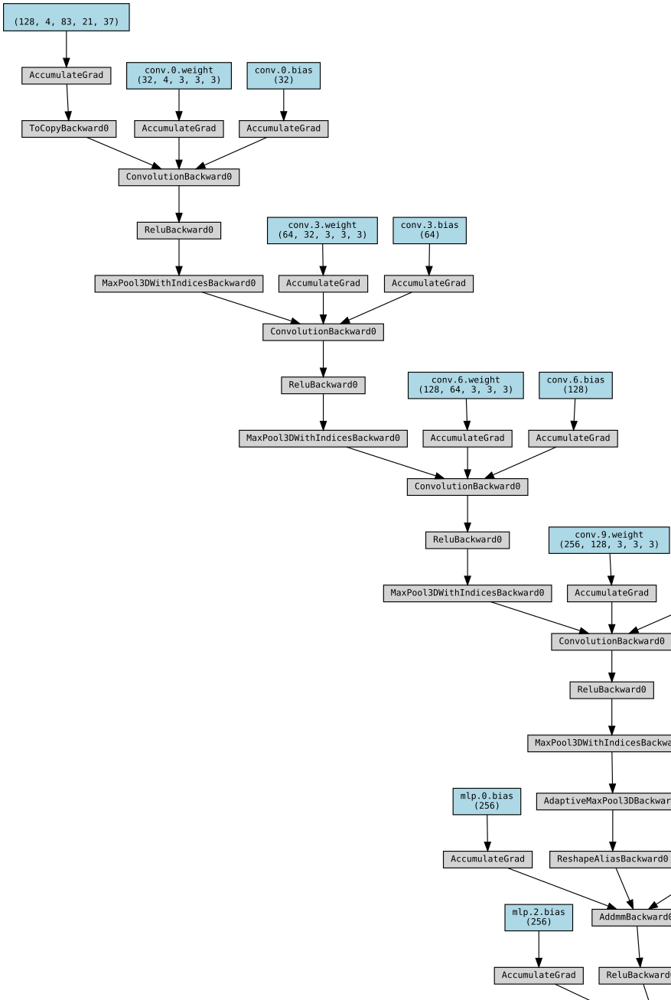

In [38]:
example_batch_nerf_input, _ = next(iter(train_loader))
example_batch_nerf_input = example_batch_nerf_input.requires_grad_(True).to(device)
example_grasp_success_prediction = nerf_to_grasp_success_model(example_batch_nerf_input)

dot = None
try:
    dot = make_dot(
        example_grasp_success_prediction,
        params={
            **dict(nerf_to_grasp_success_model.named_parameters()),
            **{"NERF INPUT": example_batch_nerf_input},
            **{"GRASP SUCCESS": example_grasp_success_prediction},
        },
    )
    model_graph_filename = "model_graph.png"
    model_graph_filename_split = model_graph_filename.split(".")
    print(f"Saving to {model_graph_filename}...")
    dot.render(model_graph_filename_split[0], format=model_graph_filename_split[1])
    print(f"Done saving to {model_graph_filename}")
except:
    print("Failed to save model graph to file.")

dot

# Training Setup

In [39]:
@localscope.mfc
def save_checkpoint(
    checkpoint_workspace_dir_path: str,
    epoch: int,
    nerf_to_grasp_success_model: NeRF_to_Grasp_Success_Model,
    optimizer: torch.optim.Optimizer,
):
    checkpoint_filepath = os.path.join(
        checkpoint_workspace_dir_path, f"checkpoint_{epoch:04}.pt"
    )
    print(f"Saving checkpoint to {checkpoint_filepath}")
    torch.save(
        {
            "epoch": epoch,
            "nerf_to_grasp_success_model": nerf_to_grasp_success_model.state_dict(),
            "optimizer": optimizer.state_dict(),
        },
        checkpoint_filepath,
    )
    print("Done saving checkpoint")

In [40]:
@localscope.mfc(
    allowed=[
        "cfg",
        "INPUT_EXAMPLE_SHAPE",
        "nerf_coordinate_min",  # HACK: Should be not a global
        "nerf_coordinate_max",
        "nerf_density_min",
        "nerf_density_max",
        "NERF_COORDINATE_START_IDX",
        "NERF_COORDINATE_END_IDX",
        "NERF_DENSITY_START_IDX",
        "NERF_DENSITY_END_IDX",
    ]
)
def preprocess(
    nerf_grid_inputs: torch.Tensor,
):
    # TODO: Look into exponential weighting of density
    assert nerf_grid_inputs.shape[1:] == INPUT_EXAMPLE_SHAPE
    nerf_coordinates = nerf_grid_inputs[:, NERF_COORDINATE_START_IDX:NERF_COORDINATE_END_IDX]
    nerf_densities = nerf_grid_inputs[:, NERF_DENSITY_START_IDX:NERF_DENSITY_END_IDX]

    # Normalize coordinates
    normalized_nerf_coordinates = (nerf_coordinates - nerf_coordinate_min) / (
        nerf_coordinate_max - nerf_coordinate_min
    )
    normalized_nerf_densities = (nerf_densities - nerf_density_min) / (
        nerf_density_max - nerf_density_min
    )
    normalized_nerf_grid_inputs = torch.cat(
        [normalized_nerf_coordinates, normalized_nerf_densities], dim=1
    )
    assert normalized_nerf_grid_inputs.shape == nerf_grid_inputs.shape

    return normalized_nerf_grid_inputs

In [41]:


class Phase(Enum):
    TRAIN = auto()
    VAL = auto()
    TEST = auto()


@localscope.mfc(allowed=["tqdm"])
def iterate_through_dataloader(
    phase: Phase,
    dataloader: DataLoader,
    nerf_to_grasp_success_model: NeRF_to_Grasp_Success_Model,
    device: str,
    ce_loss_fn: nn.CrossEntropyLoss,
    wandb_log_dict: Dict[str, Any],
    cfg: Optional[TrainingConfig] = None,
    optimizer: Optional[torch.optim.Optimizer] = None,
    log_grad: bool = False,
):
    assert phase in [Phase.TRAIN, Phase.VAL, Phase.TEST]
    if phase == Phase.TRAIN:
        nerf_to_grasp_success_model.train()
        assert cfg is not None and optimizer is not None
    else:
        nerf_to_grasp_success_model.eval()
        assert cfg is None and optimizer is None

    with torch.set_grad_enabled(phase == Phase.TRAIN):
        losses_dict = defaultdict(list)
        grads_dict = defaultdict(list)

        end_time = time.time()
        for nerf_grid_inputs, grasp_successes in (pbar := tqdm(dataloader)):
            dataload_time_taken = time.time() - end_time

            # Forward pass
            start_forward_pass_time = time.time()
            nerf_grid_inputs = nerf_grid_inputs.to(device)
            # nerf_grid_inputs = preprocess(nerf_grid_inputs)  # TODO: (Should we preprocess?)
            grasp_successes = grasp_successes.to(device)

            grasp_success_logits = nerf_to_grasp_success_model.get_success_logits(
                nerf_grid_inputs
            )
            ce_loss = ce_loss_fn(input=grasp_success_logits, target=grasp_successes)
            total_loss = ce_loss
            forward_pass_time_taken = time.time() - start_forward_pass_time

            # Gather data and report
            start_loss_log_time = time.time()
            losses_dict[f"{phase.name.lower()}_loss"].append(total_loss.item())
            loss_log_time_taken = time.time() - start_loss_log_time

            # Gradient step
            start_backward_pass_time = time.time()
            if phase == Phase.TRAIN and optimizer is not None:
                optimizer.zero_grad()
                total_loss.backward()
                optimizer.step()
            backward_pass_time_taken = time.time() - start_backward_pass_time

            start_grad_log_time = time.time()
            if phase == Phase.TRAIN and log_grad:
                grad_abs_values = torch.concat(
                    [
                        p.grad.data.abs().flatten()
                        for p in nerf_to_grasp_success_model.parameters()
                        if p.grad is not None and p.requires_grad
                    ]
                )
                grads_dict[f"{phase.name.lower()}_max_grad_abs_value"].append(
                    torch.max(grad_abs_values).item()
                )
                grads_dict[f"{phase.name.lower()}_median_grad_abs_value"].append(
                    torch.median(grad_abs_values).item()
                )
                grads_dict[f"{phase.name.lower()}_mean_grad_abs_value"].append(
                    torch.mean(grad_abs_values).item()
                )
                grads_dict[f"{phase.name.lower()}_mean_grad_norm_value"].append(
                    torch.norm(grad_abs_values).item()
                )
            grad_log_time_taken = time.time() - start_grad_log_time

            start_grad_clip_time = time.time()
            if (
                phase == Phase.TRAIN
                and cfg is not None
                and cfg.grad_clip_val is not None
            ):
                torch.nn.utils.clip_grad_value_(
                    nerf_to_grasp_success_model.parameters(),
                    cfg.grad_clip_val,
                )
            grad_clip_time_taken = time.time() - start_grad_clip_time

            batch_time_taken = time.time() - end_time

            # Set description
            description = " | ".join(
                [
                    f"{phase.name.lower()} (ms)",
                    f"Batch: {1000*batch_time_taken:.0f}",
                    f"Data: {1000*dataload_time_taken:.0f}",
                    f"Fwd: {1000*forward_pass_time_taken:.0f}",
                    f"Bwd: {1000*backward_pass_time_taken:.0f}",
                    f"Grad: {1000*grad_log_time_taken:.0f}",
                    # f"Clip: {1000*grad_clip_time_taken:.0f}",
                    f"Loss Log: {1000*loss_log_time_taken:.0f}",
                    f"loss: {np.mean(losses_dict[f'{phase.name.lower()}_loss']):.5f}",
                ]
            )
            pbar.set_description(description)
            end_time = time.time()

    for loss_name, losses in losses_dict.items():
        wandb_log_dict[loss_name] = np.mean(losses)

    # Extra debugging
    for grad_name, grad_vals in grads_dict.items():
        if "_max_" in grad_name:
            wandb_log_dict[grad_name] = np.max(grad_vals)
        elif "_mean_" in grad_name:
            wandb_log_dict[grad_name] = np.mean(grad_vals)
        elif "_median_" in grad_name:
            wandb_log_dict[grad_name] = np.median(grad_vals)
        else:
            print(f"WARNING: grad_name = {grad_name} will not be logged")

    return

In [42]:
@torch.no_grad()
@localscope.mfc(allowed=["tqdm"])
def plot_confusion_matrix(
    phase: Phase,
    dataloader: DataLoader,
    nerf_to_grasp_success_model: NeRF_to_Grasp_Success_Model,
    device: str,
    wandb_log_dict: Dict[str, Any],
):
    preds, ground_truths = [], []
    for nerf_grid_inputs, grasp_successes in (pbar := tqdm(dataloader)):
        nerf_grid_inputs = nerf_grid_inputs.to(device)
        pbar.set_description(f"{phase.name.lower()} Confusion Matrix")
        pred = (
            nerf_to_grasp_success_model.get_success_probability(nerf_grid_inputs)
            .argmax(axis=1)
            .tolist()
        )
        ground_truth = grasp_successes.tolist()
        preds, ground_truths = preds + pred, ground_truths + ground_truth

    wandb_log_dict[
        f"{phase.name.lower()}_confusion_matrix"
    ] = wandb.plot.confusion_matrix(
        preds=preds,
        y_true=ground_truths,
        class_names=["Fail", "Success"],
        title=f"{phase.name.lower()} Confusion Matrix",
    )

    preds = torch.tensor(preds)
    ground_truths = torch.tensor(ground_truths)
    num_correct = torch.sum(preds == ground_truths).item()
    num_datapoints = len(preds)
    wandb_log_dict[f"{phase.name.lower()}_accuracy"] = (
        num_correct / num_datapoints * 100
    )

# Training

In [43]:
@localscope.mfc(allowed=["tqdm"])
def run_training_loop(
    cfg: TrainingConfig,
    train_loader: DataLoader,
    val_loader: DataLoader,
    nerf_to_grasp_success_model: NeRF_to_Grasp_Success_Model,
    device: str,
    ce_loss_fn: nn.CrossEntropyLoss,
    optimizer: torch.optim.Optimizer,
    start_epoch: int,
    checkpoint_workspace_dir_path: str,
):
    training_loop_base_description = "Training Loop"
    for epoch in (
        pbar := tqdm(
            range(start_epoch, cfg.n_epochs), desc=training_loop_base_description
        )
    ):
        wandb_log_dict = {}
        wandb_log_dict["epoch"] = epoch

        # Save checkpoint
        start_save_checkpoint_time = time.time()
        if epoch % cfg.save_checkpoint_freq == 0 and (
            epoch != 0 or cfg.save_checkpoint_on_epoch_0
        ):
            save_checkpoint(
                checkpoint_workspace_dir_path=checkpoint_workspace_dir_path,
                epoch=epoch,
                nerf_to_grasp_success_model=nerf_to_grasp_success_model,
                optimizer=optimizer,
            )
        save_checkpoint_time_taken = time.time() - start_save_checkpoint_time

        # Create confusion matrix
        start_confusion_matrix_time = time.time()
        if epoch % cfg.confusion_matrix_freq == 0 and (
            epoch != 0 or cfg.save_confusion_matrix_on_epoch_0
        ):
            plot_confusion_matrix(
                phase=Phase.TRAIN,
                dataloader=train_loader,
                nerf_to_grasp_success_model=nerf_to_grasp_success_model,
                device=device,
                wandb_log_dict=wandb_log_dict,
            )
            plot_confusion_matrix(
                phase=Phase.VAL,
                dataloader=val_loader,
                nerf_to_grasp_success_model=nerf_to_grasp_success_model,
                device=device,
                wandb_log_dict=wandb_log_dict,
            )
        confusion_matrix_time = time.time() - start_confusion_matrix_time

        # Val
        start_val_time = time.time()
        if epoch % cfg.val_freq == 0 and (epoch != 0 or cfg.val_on_epoch_0):
            iterate_through_dataloader(
                phase=Phase.VAL,
                dataloader=val_loader,
                nerf_to_grasp_success_model=nerf_to_grasp_success_model,
                device=device,
                ce_loss_fn=ce_loss_fn,
                wandb_log_dict=wandb_log_dict,
            )
        val_time_taken = time.time() - start_val_time

        # Train
        start_train_time = time.time()
        log_grad = epoch % cfg.log_grad_freq == 0 and (
            epoch != 0 or cfg.log_grad_on_epoch_0
        )
        iterate_through_dataloader(
            phase=Phase.TRAIN,
            dataloader=train_loader,
            nerf_to_grasp_success_model=nerf_to_grasp_success_model,
            device=device,
            ce_loss_fn=ce_loss_fn,
            wandb_log_dict=wandb_log_dict,
            cfg=cfg,
            optimizer=optimizer,
            log_grad=log_grad,
        )
        train_time_taken = time.time() - start_train_time

        wandb.log(wandb_log_dict)

        # Set description
        description = " | ".join(
            [
                training_loop_base_description + " (s)",
                f"Save: {save_checkpoint_time_taken:.0f}",
                f"CM: {confusion_matrix_time:.0f}",
                f"Train: {train_time_taken:.0f}",
                f"Val: {val_time_taken:.0f}",
            ]
        )
        pbar.set_description(description)

In [44]:
wandb.watch(nerf_to_grasp_success_model, log="gradients", log_freq=100)

[]

In [45]:
@localscope.mfc
def compute_class_weight_np(train_dataset: Subset):
    try:
        grasp_successes_np = train_dataset.dataset.grasp_successes[
            train_dataset.indices
        ].numpy()
        class_weight_np = compute_class_weight(
            class_weight="balanced",
            classes=np.unique(grasp_successes_np),
            y=grasp_successes_np,
        )
    except Exception as e:
        print(f"Failed to compute class weight: {e}")
        print("Using default class weight")
        class_weight_np = np.array([1.0, 1.0])
    return class_weight_np


class_weight = (
    torch.from_numpy(compute_class_weight_np(train_dataset)).float().to(device)
)
print(f"Class weight: {class_weight}")
ce_loss_fn = nn.CrossEntropyLoss(weight=class_weight)

Class weight: tensor([1.4073, 0.7755], device='cuda:0')


In [46]:
run_training_loop(
    cfg=cfg.training,
    train_loader=train_loader,
    val_loader=val_loader,
    nerf_to_grasp_success_model=nerf_to_grasp_success_model,
    device=device,
    ce_loss_fn=ce_loss_fn,
    optimizer=optimizer,
    start_epoch=start_epoch,
    checkpoint_workspace_dir_path=checkpoint_workspace_dir_path,
)

Training Loop:   0%|                                                                                         |…

Saving checkpoint to Train_NeRF_Grasp_Metric_workspaces/large-model_normalize_3-categories/checkpoint_0000.pt
Done saving checkpoint


  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

Saving checkpoint to Train_NeRF_Grasp_Metric_workspaces/large-model_normalize_3-categories/checkpoint_0005.pt
Done saving checkpoint


  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

Saving checkpoint to Train_NeRF_Grasp_Metric_workspaces/large-model_normalize_3-categories/checkpoint_0010.pt
Done saving checkpoint


  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

Saving checkpoint to Train_NeRF_Grasp_Metric_workspaces/large-model_normalize_3-categories/checkpoint_0015.pt
Done saving checkpoint


  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

  0%|                                                                                                        |…

# Test

In [47]:
nerf_to_grasp_success_model.eval()
wandb_log_dict = {}
print(f"Running test metrics on epoch {cfg.training.n_epochs}")
wandb_log_dict["epoch"] = cfg.training.n_epochs
iterate_through_dataloader(
    phase=Phase.TEST,
    dataloader=test_loader,
    nerf_to_grasp_success_model=nerf_to_grasp_success_model,
    device=device,
    ce_loss_fn=ce_loss_fn,
    wandb_log_dict=wandb_log_dict,
)

plot_confusion_matrix(
    phase=Phase.TEST,
    dataloader=test_loader,
    nerf_to_grasp_success_model=nerf_to_grasp_success_model,
    device=device,
    wandb_log_dict=wandb_log_dict,
)

wandb.log(wandb_log_dict)

Running test metrics on epoch 20


  0%|                                                                                                         …

  0%|                                                                                                         …

# Save Model

In [48]:
save_checkpoint(
    checkpoint_workspace_dir_path=checkpoint_workspace_dir_path,
    epoch=cfg.training.n_epochs,
    nerf_to_grasp_success_model=nerf_to_grasp_success_model,
    optimizer=optimizer,
)

Saving checkpoint to Train_NeRF_Grasp_Metric_workspaces/large-model_normalize_3-categories/checkpoint_0020.pt
Done saving checkpoint
